In [3]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objects as go
from umap import UMAP
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from ipywidgets import interact, interactive, fixed, interact_manual
import hdbscan
import seaborn as sns
from matplotlib.pyplot import get_cmap
from sklearn.metrics import silhouette_samples,silhouette_score
from matplotlib.pyplot import cm
from sklearn.cluster import SpectralClustering, MiniBatchKMeans, MeanShift,AgglomerativeClustering
from sklearn.mixture import GaussianMixture
import sys
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from scipy.spatial.distance import squareform

train = pd.read_csv('c:/Finance_projects/Optiver-Realized-Volatility-Prediction/data/train.csv')
train.head()
unique_stock_ids = train['stock_id'].unique()

<frozen importlib._bootstrap>:241: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [291]:
## Visualize the clustered summary stats features

def plot_stations_of_clusters(labels, X_feat,plot_type,angular_labels,plot_title):
    unique_clusters = np.unique(labels)
    cluster_to_stocks_feats_dict = { l: [] for l in unique_clusters}
    cluster_to_stocks_ids_dict = { l: [] for l in unique_clusters}

    idx=0
    for l in labels:
      cluster_to_stocks_feats_dict[l].append(X_feat[idx])
      cluster_to_stocks_ids_dict[l].append(idx)
      idx+=1

    num_features = X_feat.shape[1]

    print(cluster_to_stocks_feats_dict[0][0])

    ################## par coords plot ##################
    if(plot_type == 'par_coords'): # parallel coordinates
        for key in cluster_to_stocks_feats_dict.keys():
          #plt.figure(figsize=(10,10))
          #fig = go.Figure()
          #fig1 = go.Figure()
          fig2, ax2 = plt.subplots(figsize=(30,5))

          color_feature = 0  # The feature index to use for colors
          color_map = get_cmap('tab20')  # Choose a colormap
          
          for stock_feats, stock_id in zip(cluster_to_stocks_feats_dict[key], cluster_to_stocks_ids_dict[key]):   
            sample = stock_feats  # Get the current sample
            color = color_map(stock_id)  # Get the color based on the color feature value
            ax2.plot(range(num_features), sample, color=color, alpha=0.7, label=stock_id)

          ax2.set_xticks(range(num_features))
          ax2.set_xticklabels([i for i in angular_labels])
          ax2.set_ylabel('Normalized Value')
          # Adjust the y-axis limits based on your data range
          #ax2.set_ylim(0, 1)  # Modify as needed
          ax2.set_title(plot_title+', cluster: '+str(key)+' has '+str(len(cluster_to_stocks_feats_dict[key]))+' stocks')
          #ax2.legend()
          ax2.grid(True, linestyle='--')
          ax2.legend()
          #fig2.tight_layout()
          fig2.show()
    ################## par coords plot ##################

    return 

In [292]:
## feature normalization
class feat_transformation():
    def __init__(self,):
        return
    def feature_normalization(self,X_train):
        # ensure that features of different scale are comparable using euclidean distance
        self.scaler = MinMaxScaler() #StandardScaler()
        self.scaler.fit(X_train)
        X_train_normalized = self.scaler.transform(X_train)
        return X_train_normalized

    def inv_feature_normalization(self,X_train_normalized):
        # ensure that features of different scale are comparable using euclidean distance
        X_train = self.scaler.inverse_transform(X_train_normalized)
        return X_train

## create feature matrix from individual feature dictionaries
def create_feature_matrix(args):
    X_feat = np.zeros((len(args[1]),len(args)))
    for f in range(len(args)):
        X_feat[:,f] = np.array(list(args[f].values()))
    return X_feat

# ## Dimensionality reduction by UMAP
def plot_UMAP_3d(X_feat,n_neighbors,min_dist,metric,print_msg):
    umap_3d = UMAP(n_components=3,n_neighbors=n_neighbors,min_dist=min_dist,metric=metric, init='random', random_state=0)
    proj_3d = umap_3d.fit_transform(X_feat)
    fig = go.Scatter3d(
        x=proj_3d[:, 0],  # X-axis values from the low-dimensional representation
        y=proj_3d[:, 1],  # Y-axis values from the low-dimensional representation
        z=proj_3d[:, 2],  # Z-axis values from the low-dimensional representation
        mode='markers',
        marker=dict(
            size=5,
            color=np.arange(len(X_feat)),  # Color points based on a range of values (e.g., sample index)
            colorscale='Viridis',  # Choose a colorscale
            showscale=True  # Show the colorbar
        ),name=print_msg,
    )
    #fig.show()
    return fig

def plot_UMAP_interactive(X_feat,n_neighbors,min_dist,metric,print_msg):
    umap_3d = UMAP(n_components=3,n_neighbors=n_neighbors,min_dist=min_dist,metric=metric, init='random', random_state=0)
    proj_3d = umap_3d.fit_transform(X_feat)
    x=proj_3d[:,0]
    y=proj_3d[:,1]
    z=proj_3d[:,2]
    # Create the figure and subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

    # Plot 1 - 2D Plot
    ax1.scatter(x, y,c=np.arange(len(X_feat)))
    ax1.set_xlabel('X')
    ax1.set_ylabel('Y')
    ax1.set_title(print_msg)

    # Plot 2 - 3D Plot
    ax2 = fig.add_subplot(122, projection='3d')
    ax2.scatter(x, y, z, c=np.arange(len(X_feat)))
    ax2.set_xlabel('X')
    ax2.set_ylabel('Y')
    ax2.set_zlabel('Z')
    ax2.set_title(print_msg)

    # Adjust the spacing between subplots
    plt.subplots_adjust(wspace=0.5)

    # Display the plot
    plt.show()
    return





In [293]:
## verify the clustering using silhouette score for particular clustring parameters
def plot_silhouette_scores(X_train,labels,metric,linkage,clustering_type):
    unique_clusters = np.unique(labels)
    num_clusters = len(unique_clusters)
    sample_silhouette_values = silhouette_samples(X=X_train, labels=labels,metric=metric)
    silhouette_avg = silhouette_score(X=X_train, labels=labels,metric=metric)
    fig, ax1 = plt.subplots()
    y_lower = 10
    mean_num_zones_dev_in_clusters = []

    mean_num_zones_in_clusters = X_train.shape[0] /num_clusters

    for i in range(num_clusters): # exclude the
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[labels == i]
        ith_cluster_silhouette_values.sort()
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        color = cm.nipy_spectral(float(i) / num_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )
        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples
        mean_num_zones_dev_in_clusters.append(abs(mean_num_zones_in_clusters - np.sum(labels == i) ))

    ax1.set_title("metric: "+metric+", linkage: "+linkage+", silhouette_avg: "+str(silhouette_avg)+", num_clusters: "+str(num_clusters)+", Cluster_type : "+clustering_type )
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")
    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    num_neg_silhouette_scores = np.sum(sample_silhouette_values < 0 )
    min_silhouette_score = min(sample_silhouette_values)
    dev_from_mean_num_zone = np.sum(np.array(mean_num_zones_dev_in_clusters))
    return silhouette_avg, num_neg_silhouette_scores, min_silhouette_score,dev_from_mean_num_zone

In [294]:
## target distribution for each stock
for st_id in train['stock_id'].unique():
    if st_id < 20 or st_id > 20: continue # select stocks for viewing
    fig1 = px.histogram(train[train['stock_id'] == st_id],x='target',title='target (volatility) distribution of stock '+str(st_id))
    fig1.show()


##### INSIGHTS

-


In [295]:
## summary statistics of each stocks target column
total_time_id ={} # total number of time ids in each stock
mean_vol = {}
std_vol = {}
min_vol = {}
p25_vol = {}
median_vol = {}
p75_vol = {}
max_vol = {}

for st_id in train['stock_id'].unique():
    sum_stats = train[train['stock_id'] == st_id]['target'].describe()
    total_time_id[st_id] = sum_stats[0]
    mean_vol[st_id] = sum_stats[1]
    std_vol[st_id] = sum_stats[2]
    min_vol[st_id] = sum_stats[3]
    p25_vol[st_id] = sum_stats[4]
    median_vol[st_id] = sum_stats[5]
    p75_vol[st_id] = sum_stats[6]
    max_vol[st_id] = sum_stats[7]



In [296]:
## number of time_ids in each stock
tt_id_df = pd.DataFrame({'total_time_ids':total_time_id.values(),'stock #':total_time_id.keys()})
fig = px.line(tt_id_df,x='stock #',y='total_time_ids',title='total number of time_ids available in each stock')
fig.show()

##### INSIGHTS

-


In [297]:
## median volatility in each stock
median_vol_df = pd.DataFrame({'median_vol':median_vol.values(),'stock #':median_vol.keys()})
fig = px.bar(median_vol_df,x='stock #',y='median_vol',title='median_vol in each stock')
fig.show()

##### INSIGHTS

-


In [298]:
## mean volatility in each stock
mean_vol_df = pd.DataFrame({'mean_vol':mean_vol.values(),'stock #':mean_vol.keys()})
fig = px.bar(mean_vol_df,x='stock #',y='mean_vol',title='mean_vol in each stock')
fig.show()

##### INSIGHTS

-


In [299]:
## std volatility in each stock
std_vol_df = pd.DataFrame({'std_vol':std_vol.values(),'stock #':std_vol.keys()})
fig = px.bar(std_vol_df,x='stock #',y='std_vol',title='std_vol in each stock')
fig.show()

##### INSIGHTS

-


In [300]:
## min volatility in each stock
min_vol_df = pd.DataFrame({'min_vol':min_vol.values(),'stock #':min_vol.keys()})
fig = px.bar(min_vol_df,x='stock #',y='min_vol',title='min_vol in each stock')
fig.show()

##### INSIGHTS

-


In [301]:
## max volatility in each stock
max_vol_df = pd.DataFrame({'max_vol':max_vol.values(),'stock #':max_vol.keys()})
fig = px.bar(max_vol_df,x='stock #',y='max_vol',title='max_vol in each stock')
fig.show()

##### INSIGHTS

-


In [302]:
## box plot of individual stocks target column
px.box(train[train['stock_id'] < 30],x='stock_id',y='target',title='box plot of stock # < 30')


##### INSIGHTS

-


In [303]:
## box plot of individual stocks target column
px.box(train[(train['stock_id'] >= 30) & (train['stock_id'] <= 60)],x='stock_id',y='target',title='box plot of stock # > 30 and < 60')


##### INSIGHTS

-


In [304]:
## box plot of individual stocks target column
px.box(train[(train['stock_id'] >= 60) & (train['stock_id'] <= 90)],x='stock_id',y='target',title='box plot of stock # > 60 and < 90')


##### INSIGHTS

-


In [305]:
## box plot of individual stocks target column
px.box(train[(train['stock_id'] >= 90) & (train['stock_id'] <= 130)],x='stock_id',y='target',title='box plot of stock # > 90')


##### Cluster based on Distribution i.e. summary stats. features like mean, median, p25, mode etc...


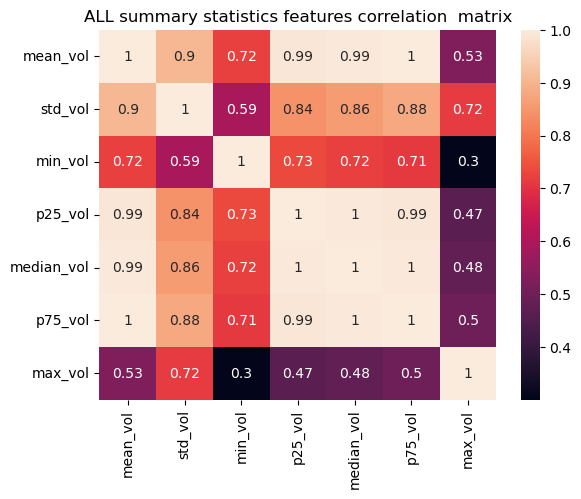

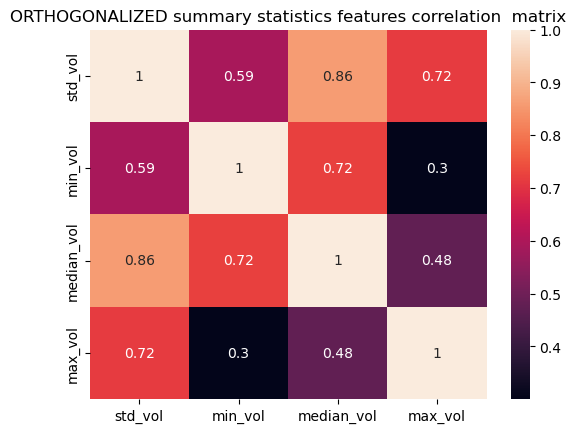

In [308]:
## check for correlated features and ensure feature orthogonalization
X_feat = create_feature_matrix([mean_vol,std_vol,min_vol,p25_vol,median_vol,p75_vol,max_vol]) 
plt.figure()
sns.heatmap(pd.DataFrame(X_feat).corr(), annot=True, xticklabels=['mean_vol','std_vol','min_vol','p25_vol','median_vol','p75_vol','max_vol'],yticklabels=['mean_vol','std_vol','min_vol','p25_vol','median_vol','p75_vol','max_vol'])
plt.title('ALL summary statistics features correlation  matrix')
plt.show()
# removed/ORTHOGONALIZED correlated features, mean_vol, p25_vol & p75_vol
new_X_feat = [std_vol,min_vol,median_vol,max_vol]
X_feat = create_feature_matrix(new_X_feat) 
plt.figure()
sns.heatmap(pd.DataFrame(X_feat).corr(), annot=True,xticklabels=['std_vol','min_vol','median_vol','max_vol'],yticklabels=['std_vol','min_vol','median_vol','max_vol'])
plt.title('ORTHOGONALIZED summary statistics features correlation  matrix')
plt.show()

In [309]:
## simple clustering based on summary statistics

## 1) perform dim. reduction to visualize the summary stats. vector distribution in low dim. space in order to choose approapriate clustering algorithm
## lower dim. distribution of summary stats. vector is representative of the original high dim. distribution
plt.close('all')
print_msg = 'UMAP 3d'

feat_transform = feat_transformation()
X_feat_normalized = feat_transform.feature_normalization(X_feat)

### static UMAP
distance_metric = 'euclidean' # 'euclidean', 'manhattan'
print_msg = 'UMAP 3d,'+' distance metric: '+distance_metric
fig_umap_3d = sp.make_subplots(specs=[[{'type': 'surface'} for i in range(1)]])
fig_umap_3d.add_trace(plot_UMAP_3d(X_feat_normalized,40,0.9,distance_metric,print_msg))
fig_umap_3d.update_layout(height=900 , width=900,title='UMAP 3d,'+' distance metric: '+distance_metric)
fig_umap_3d.show()

# ## dynamic UMAP
# interactive_UMAP_plot=interactive(plot_UMAP_interactive,X_feat=X_feat_normalized,print_msg=print_msg,n_neighbors=(10,100,20),min_dist=(0,1.0,0.1),metric=['euclidean','mahalanobis','manhattan'])
# display(interactive_UMAP_plot)





c:\Users\josepeeterson.er\Miniconda3\envs\optiver\lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



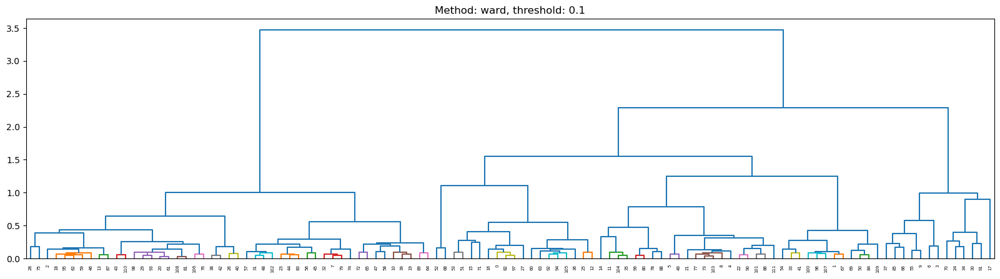

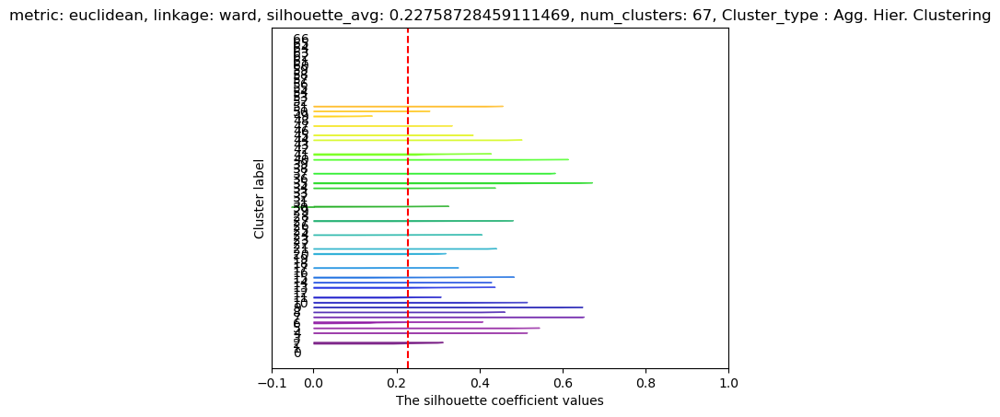

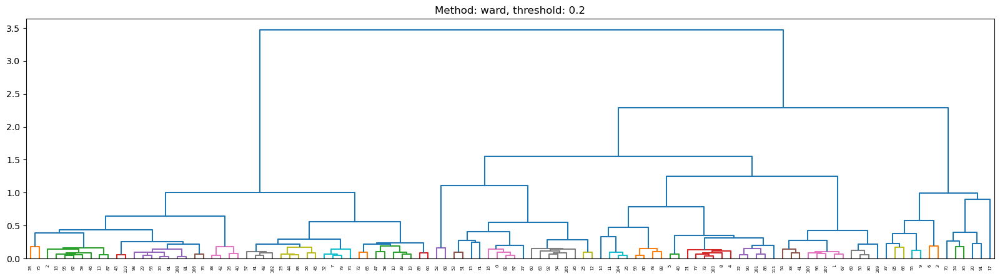

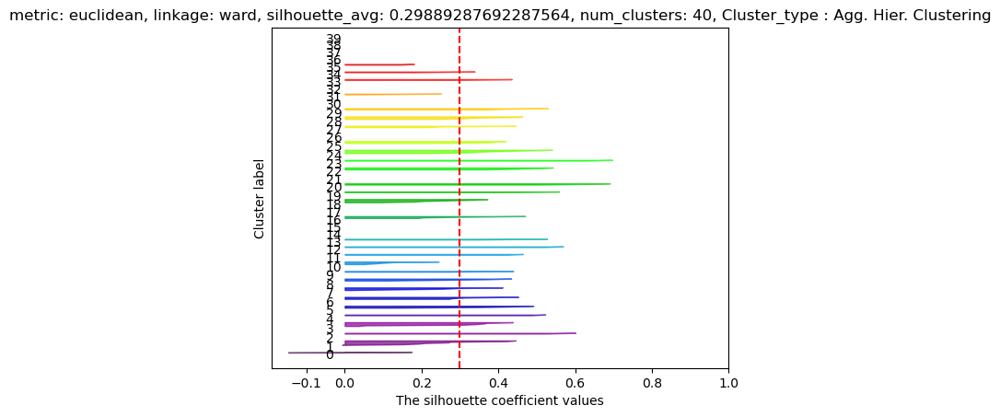

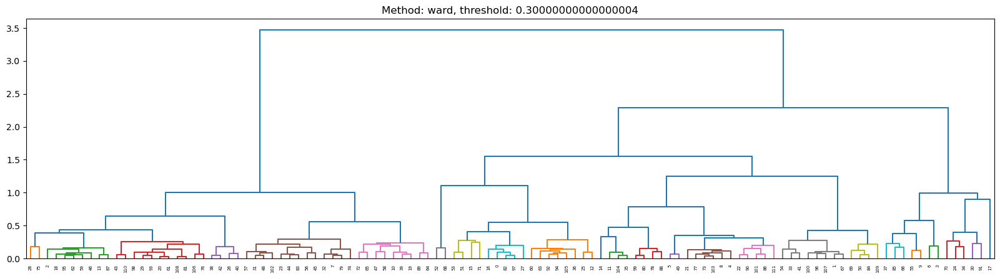

...

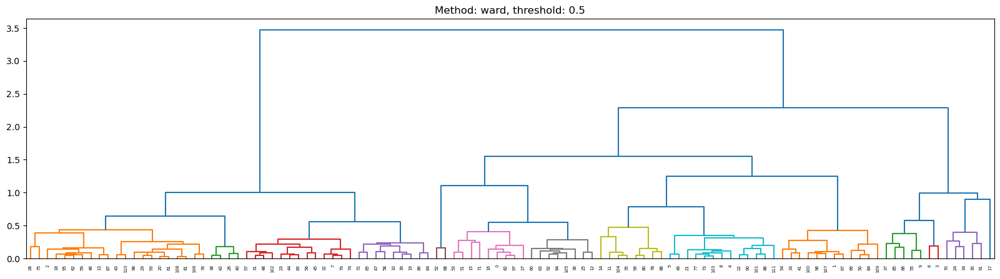

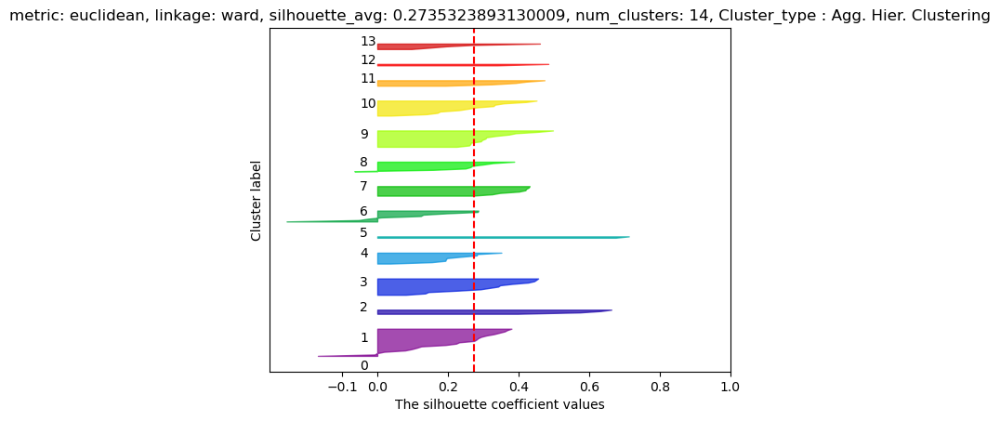

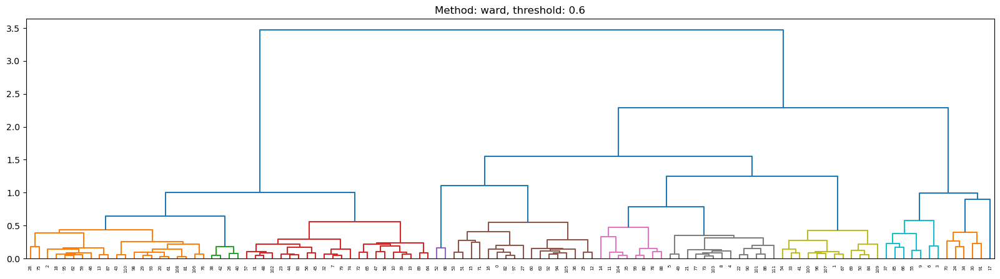

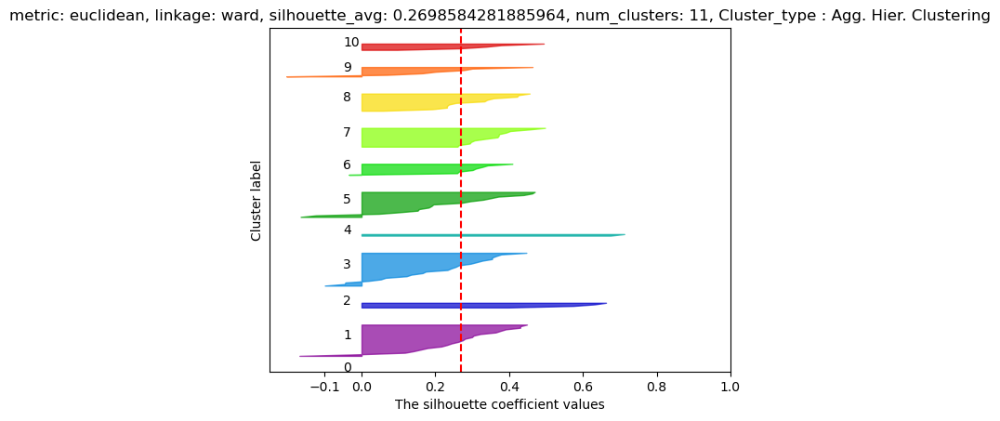

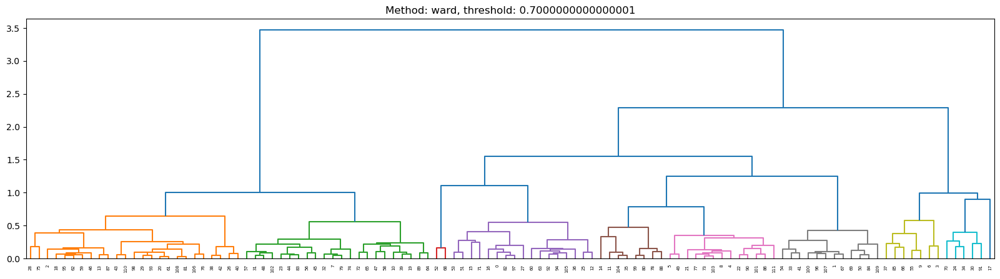

['euclidean', 'ward', 0.2, 2, -0.14743776925201948, 61.400000000000006]

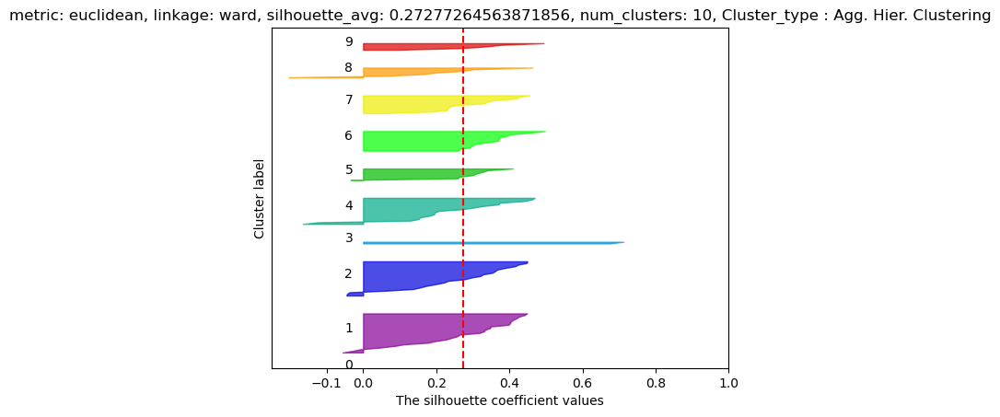

In [322]:
## Cluster the summary stats. vectors using agglomerative hierarchical clustering

#['single','complete','average','weighted','centroid','median','ward']
clustering_type = 'Agg. Hier. Clustering'
metrics = ['euclidean'] # ['cityblock', 'mahalanobis']
Best_silhouette_parameters = {}
for metric in metrics:
    for method in ['ward']:
        Z = linkage(y=X_feat_normalized, method=method, metric=metric, optimal_ordering=True)

        for t in np.arange(0.1,0.8,0.1):
            # Calculate the cluster
            labels = fcluster(Z, t, criterion='distance')
            # Keep the indices to sort labels
            labels_order = np.argsort(labels)

            plt.figure(figsize=(20,5))
            plt.title("Method: {}, threshold: {}".format(method,t))
            dendrogram(Z,color_threshold=t)
            plt.show()

            silhouette_avg, num_neg_silhouette_scores, min_silhouette_score,dev_from_mean_num_zone = plot_silhouette_scores(X_feat_normalized,labels,'euclidean',method,clustering_type)
            Best_silhouette_parameters[silhouette_avg] = [metric,method,t,num_neg_silhouette_scores, min_silhouette_score,dev_from_mean_num_zone] 

max_silhouette_avg = max(Best_silhouette_parameters.keys())
print(f'Best silhouette score: {max_silhouette_avg} ,Best_silhouette_parameters: {Best_silhouette_parameters[max_silhouette_avg]}')


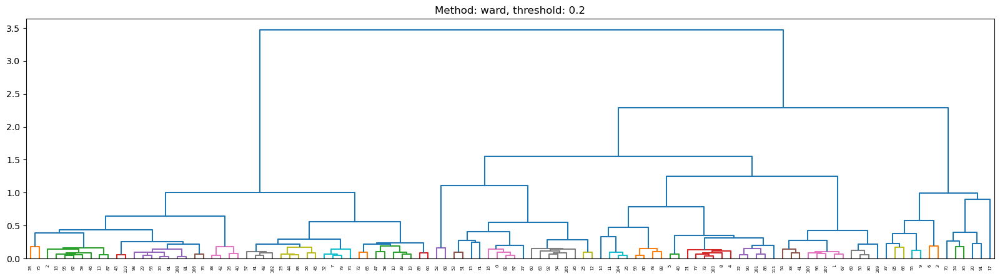

Best silhouette score: 0.29889287692287564 ,Best_silhouette_parameters: ('euclidean', 'ward', 0.2, 2, -0.14743776925201948, 61.400000000000006)


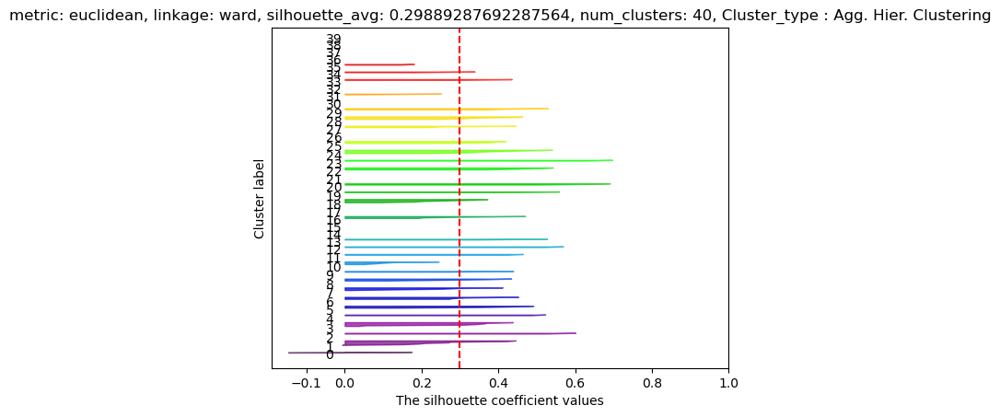

In [325]:
## Select the BEST agglomerative hierarchical clustering

#['single','complete','average','weighted','centroid','median','ward']
clustering_type = 'Agg. Hier. Clustering'
metric = 'euclidean'
for method in ['ward']:
    Z = linkage(y=X_feat_normalized, method=method, metric=metric,optimal_ordering=True)

    for t in np.arange(0.2,0.3,0.1):
        # Calculate the cluster
        labels = fcluster(Z, t, criterion='distance')
        # Keep the indices to sort labels
        labels_order = np.argsort(labels)

        plt.figure(figsize=(20,5))
        plt.title("Method: {}, threshold: {}".format(method,t))
        dendrogram(Z,color_threshold=t)
        plt.show()

        silhouette_avg, num_neg_silhouette_scores, min_silhouette_score,dev_from_mean_num_zone = plot_silhouette_scores(X_feat_normalized,labels,'euclidean',method,clustering_type)

print(f'Best silhouette score: {silhouette_avg} ,Best_silhouette_parameters: {metric,method,t,num_neg_silhouette_scores, min_silhouette_score,dev_from_mean_num_zone}')

In [ ]:
# ## 2) perform clustering on the summary stats. vector
# ## All the stock distributions for different UMAP hyperparameters are very similar, so we can use the default UMAP hyperparameters
# ## They have a shape of points lying on a plane and stocks stretch out like a ellipse
# ## Use different clusterings

# import warnings
# warnings.filterwarnings("ignore")

# metrics = ['euclidean']
# methods = ['single','complete','average','ward']

# spectral_result_comb = []

# for num_cluster in range(2,30,1):
#     for metric in metrics:
#         for method in methods:
            
#             """ UNCOMMENT THE DESIRED CLUSTERING  below  """

#             ## SPECTRAL CLUSTERING
#             # clustering = SpectralClustering(n_clusters=num_cluster,
#             #         assign_labels='discretize',
#             #         random_state=0).fit(X_feat_normalized)
#             # clustering_type = 'spectral'

#             # MINIBATCHKMEANS CLUSTERING
#             clustering = MiniBatchKMeans(n_clusters=num_cluster,
#                                     random_state=0,
#                                     batch_size=6,
#                                     max_iter=10,
#                                     n_init="auto").fit(X_feat_normalized)
#             clustering_type = 'MINIBATCHKMEANS'

#             ## MEANSHIFT CLUSTERING
#             # clustering = MeanShift().fit(X_feat_normalized)
#             # clustering_type = 'MEANSHIFT'

#             ## WARD CLUSTERING
#             # clustering  = AgglomerativeClustering(n_clusters=num_cluster, linkage="ward").fit(X_feat_normalized)
#             # clustering_type = 'WARD'

#             silhouette_avg, num_neg_silhouette_scores, min_silhouette_score,dev_from_mean_num_zone = plot_silhouette_scores(X_feat_normalized,clustering.labels_,metric,method,clustering_type)
#             spectral_result_comb.append([silhouette_avg,num_neg_silhouette_scores, min_silhouette_score,metric,method,num_cluster,dev_from_mean_num_zone ])




In [ ]:
# ## 2) perform clustering on the summary stats. vector
# ## All the stock distributions for different UMAP hyperparameters are very similar, so we can use the default UMAP hyperparameters
# ## They have a shape of points lying on a plane and stocks stretch out like a ellipse
# ## Use HDBSCAN

# """
# Parameter search for best clustering using summary statistics Features

# """

# best_score = 0
# best_score_num_cluster_dict = {}
# cov_mat = np.cov(X_feat_normalized.T)

# for metric in ['euclidean','manhattan','mahalanobis']:# need to implement mahalanobis distance
#     if metric != 'mahalanobis':
#         for min_cluster_size in range(5,80,5):
#             for min_samples in range(1,40,2):
#                 for cluster_selection_method in ['eom','leaf']:
#                     # for each combination of parameters of hdbscan
#                     hdb = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size,min_samples=min_samples,
#                                           cluster_selection_method=cluster_selection_method, metric=metric,
#                                           gen_min_span_tree=True).fit(X_feat_normalized)
#                     # DBCV score
#                     score = hdb.relative_validity_
#                     outliers = (np.array(hdb.labels_)==-1).sum()
#                     best_score_num_cluster_dict[score] = [len(np.unique(hdb.labels_)),min_cluster_size,min_samples,cluster_selection_method,metric,outliers]
#                     #print(f'score: {score}, num of unique clusters: {len(np.unique(hdb.labels_))}' )
#                     #print(f'min_cluster_size: {min_cluster_size}, min_samples: {min_samples}, cluster_selection_method: {cluster_selection_method}, metric: {metric}' )
#                     # if we got a better DBCV, store it and the parameters
#                     if score > best_score:
#                         best_score = score
#                         best_parameters = {'min_cluster_size': min_cluster_size,
#                                   ' min_samples':  min_samples, 'cluster_selection_method': cluster_selection_method,
#                                   'metric': metric}
#     else: ## mahalanobis distance
#         for min_cluster_size in range(5,80,5):
#             for min_samples in range(1,40,2):
#                 for cluster_selection_method in ['eom','leaf']:
#                     # for each combination of parameters of hdbscan
#                     hdb = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size,min_samples=min_samples,
#                                           cluster_selection_method=cluster_selection_method, metric=metric,V=cov_mat,
#                                           gen_min_span_tree=True).fit(X_feat_normalized)
#                     # DBCV score
#                     score = hdb.relative_validity_
#                     outliers = (np.array(hdb.labels_)==-1).sum()
#                     best_score_num_cluster_dict[score] = [len(np.unique(hdb.labels_)),min_cluster_size,min_samples,cluster_selection_method,metric,outliers]
#                     #print(f'score: {score}, num of unique clusters: {len(np.unique(hdb.labels_))}' )
#                     #print(f'min_cluster_size: {min_cluster_size}, min_samples: {min_samples}, cluster_selection_method: {cluster_selection_method}, metric: {metric}' )
#                     # if we got a better DBCV, store it and the parameters
#                     if score > best_score:
#                         best_score = score
#                         best_parameters = {'min_cluster_size': min_cluster_size,
#                                   ' min_samples':  min_samples, 'cluster_selection_method': cluster_selection_method,
#                                   'metric': metric}


# print("Best DBCV score: {:.3f}".format(best_score))
# print("Best parameters: {}".format(best_parameters))



# # ## NOTABLE CLUSTERINGS
# # ## score: 0.05725910268681324, num of unique clusters: 8
# # ## min_cluster_size: 5, min_samples: 1, cluster_selection_method: leaf, metric: euclidean



In [ ]:
# """
# Plot Minimum spanning tree and dbscan cluster hierarchy from Summary statistics features
# Use the best parameters from the parameter search above
# """

# plt.close('all')

# clusterer = hdbscan.HDBSCAN(min_cluster_size= 5, min_samples= 1,cluster_selection_method='leaf', metric='euclidean', gen_min_span_tree=True)
# clusterer.fit(X_feat_normalized)

# fig = plt.figure(figsize=(10,5))
# # Plotting the minimum spanning tree in the first subplot
# clusterer.minimum_spanning_tree_.plot(
#     edge_cmap='viridis',
#     edge_alpha=0.6,
#     edge_linewidth=2
# )
# fig.show()

# fig = plt.figure(figsize=(20,10))
# # Plotting the condensed tree in the second subplot
# clusterer.condensed_tree_.plot(
#     select_clusters=True,
#     selection_palette=sns.color_palette(),
# )
# fig.show()

# print(clusterer.labels_)

In [ ]:
# """
# Visualize Summary statistical features of all clusters using parcoords plot

# """

# plt.close('all')
# plot_title = 'Summary statistics features'
# angular_labels = ['mean_vol','std_vol','min_vol','p25_vol', 'median_vol', 'p75_vol','max_vol']

# plot_stations_of_clusters(clusterer.labels_, X_feat_normalized,'par_coords',angular_labels,plot_title)


##### Cluster based on Pearson correlation between stocks for all time_ids

In [15]:
# ## toy exmaple confirmation of ffill() and bfill()  to prevent look ahead bias

# df = pd.DataFrame({'t':[2,6,11], 'v':[3,1,4]}).set_index('t')
# df
# u_t = np.array([1,2,3,4,5,6,7,8,9,10,11,12])
# df = df.reindex(u_t).ffill().bfill()
# df

In [143]:
## create df with time ids that are common to all stocks by ffill or bfill the missing values
## This is to create a correlation matrix of target values for all stocks

def find_unique_time_ids_in_all_stocks(train):
    all_time_ids = np.array([])
    for st_id in unique_stock_ids:
        all_time_ids = np.append(all_time_ids,train[train['stock_id'] == st_id]['time_id'])
    return np.unique(all_time_ids)

unique_time_ids = find_unique_time_ids_in_all_stocks(train)


train_common_time_ids_df = pd.DataFrame()
for st_id in unique_stock_ids:
    temp_df = pd.DataFrame()
    temp_df[str(st_id)] = train[train['stock_id'] == st_id]['target']
    temp_df.index = train[train['stock_id'] == st_id]['time_id']
    temp_df = temp_df.reindex(unique_time_ids).ffill().bfill() ## forward and backward fill the missing values so that data is available at all time_id
    train_common_time_ids_df = pd.concat([train_common_time_ids_df,temp_df],axis=1)

train_common_time_ids_df


,0,1,2,3,4,5,6,7,8,9,...,115,116,118,119,120,122,123,124,125,126
time_id,,,,,,,,,,,,,,,,,,,,,
5.0,0.004136,0.006340,0.001848,0.005300,0.004468,0.006234,0.007651,0.003624,0.010036,0.007291,...,0.004267,0.007944,0.003336,0.002571,0.003035,0.004862,0.002942,0.004112,0.001919,0.008067
11.0,0.001445,0.002099,0.000806,0.002774,0.001852,0.002562,0.004670,0.002458,0.002291,0.002529,...,0.001382,0.002469,0.002030,0.000839,0.001271,0.002095,0.001518,0.001891,0.001123,0.003965
16.0,0.002168,0.002456,0.001581,0.002986,0.002213,0.003253,0.004303,0.002178,0.001841,0.003299,...,0.001949,0.002195,0.003410,0.002569,0.002137,0.001893,0.002131,0.002428,0.001548,0.003161
31.0,0.002195,0.002807,0.001599,0.004437,0.002256,0.003072,0.005401,0.002149,0.003997,0.003696,...,0.002035,0.002298,0.005674,0.002115,0.001734,0.003509,0.001078,0.002182,0.001251,0.003593
62.0,0.001747,0.004312,0.001503,0.003408,0.002102,0.002824,0.004562,0.002203,0.003923,0.003689,...,0.002459,0.003704,0.003914,0.001549,0.001470,0.002151,0.001253,0.002382,0.001324,0.003496
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32751.0,0.002611,0.003741,0.001662,0.005943,0.002007,0.003966,0.004974,0.002287,0.005161,0.006234,...,0.001733,0.003795,0.002121,0.001744,0.001705,0.002850,0.001643,0.002936,0.001103,0.003461
32753.0,0.001190,0.012414,0.000925,0.002845,0.002449,0.001542,0.003272,0.001529,0.001301,0.002501,...,0.001252,0.001612,0.001842,0.001518,0.001436,0.001079,0.002507,0.001683,0.001046,0.003113
32758.0,0.004264,0.002868,0.001188,0.003415,0.002648,0.003377,0.004154,0.001977,0.003751,0.003578,...,0.002461,0.004024,0.003248,0.001840,0.001720,0.002696,0.001442,0.002811,0.001196,0.004070


In [169]:
## correlation matrix of target values for all stocks

target_corr_mat = train_common_time_ids_df.corr()
target_corr_mat

,0,1,2,3,4,5,6,7,8,9,...,115,116,118,119,120,122,123,124,125,126
0,1.000000,0.798070,0.841460,0.647471,0.852778,0.853056,0.665597,0.835231,0.521143,0.703246,...,0.853943,0.822769,0.849980,0.857607,0.858696,0.814953,0.888719,0.759692,0.860547,0.807063
1,0.798070,1.000000,0.694983,0.707773,0.791688,0.801733,0.708319,0.750894,0.723175,0.778223,...,0.813933,0.839468,0.760083,0.741288,0.799673,0.845167,0.819863,0.753699,0.730829,0.880584
2,0.841460,0.694983,1.000000,0.534588,0.835739,0.813608,0.517432,0.885969,0.415829,0.601032,...,0.841273,0.752961,0.851451,0.890355,0.826682,0.766011,0.890501,0.704816,0.943743,0.722100
3,0.647471,0.707773,0.534588,1.000000,0.650228,0.663158,0.769600,0.627592,0.593529,0.747987,...,0.688678,0.766134,0.670604,0.614615,0.729989,0.757407,0.645228,0.764252,0.575922,0.715880
4,0.852778,0.791688,0.835739,0.650228,1.000000,0.847807,0.650958,0.833176,0.551661,0.723698,...,0.848445,0.825794,0.845132,0.835639,0.841994,0.821867,0.868835,0.746809,0.846285,0.811599
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122,0.814953,0.845167,0.766011,0.757407,0.821867,0.823992,0.723928,0.805659,0.692158,0.790123,...,0.851971,0.894657,0.804392,0.770963,0.839737,1.000000,0.816422,0.817551,0.786192,0.855556
123,0.888719,0.819863,0.890501,0.645228,0.868835,0.868485,0.642725,0.878215,0.531187,0.696700,...,0.869953,0.821938,0.853334,0.908795,0.877944,0.816422,1.000000,0.776829,0.905294,0.823923
124,0.759692,0.753699,0.704816,0.764252,0.746809,0.761487,0.732119,0.757622,0.579541,0.757330,...,0.770445,0.814858,0.782857,0.747317,0.838834,0.817551,0.776829,1.000000,0.745062,0.767322
125,0.860547,0.730829,0.943743,0.575922,0.846285,0.826166,0.563016,0.896394,0.455363,0.631232,...,0.859998,0.786959,0.856633,0.911168,0.850805,0.786192,0.905294,0.745062,1.000000,0.758927


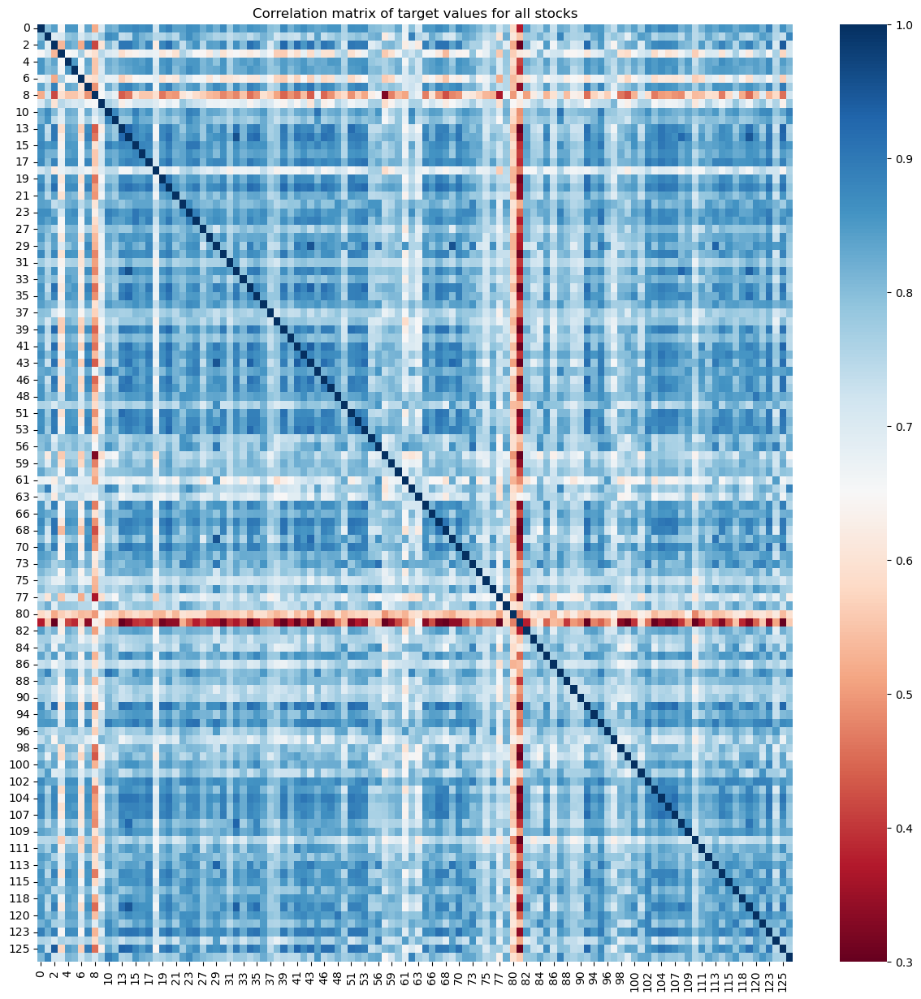

In [287]:
## Visualize the correlation matrix of target values for all stocks
# plt.figure(figsize=(12,8))
# sns.heatmap(target_corr_mat, cmap='RdBu' , vmin=0.3, vmax=1,)
# plt.title(f'Correlation matrix of target values for all stocks')
# plt.show()  

plt.figure(figsize=(15,15))
sns.heatmap(target_corr_mat, cmap='RdBu', vmin=0.3, vmax=1,)
plt.title(f'Correlation matrix of target values for all stocks')
plt.show()  

In [ ]:
## for each stock rank stocks with highest correlation to them using correlation matrix

def for_each_stock_rank_stocks_with_highest_correlation_to_them_from_correlation_matrix(target_corr_mat):
    correlated_stocks_dict = {}
    for st_id in unique_stock_ids:
        corr_st = target_corr_mat[str(st_id)]
        correlated_stocks_dict[st_id] = corr_st.sort_values(ascending=False).index.values[1:] # self-correlation
    return correlated_stocks_dict

correlated_stocks_dict = for_each_stock_rank_stocks_with_highest_correlation_to_them_from_correlation_matrix(target_corr_mat)
#correlated_stocks_dict

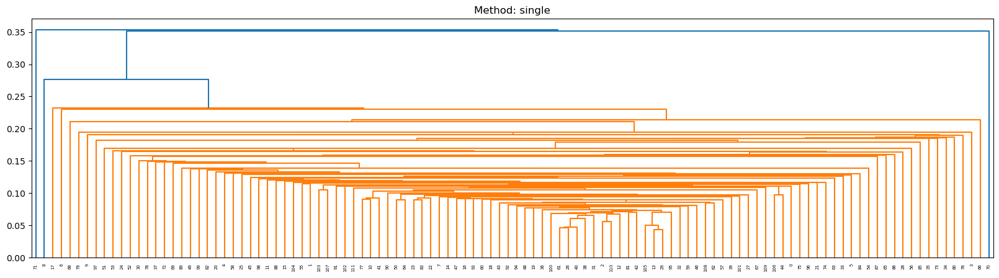

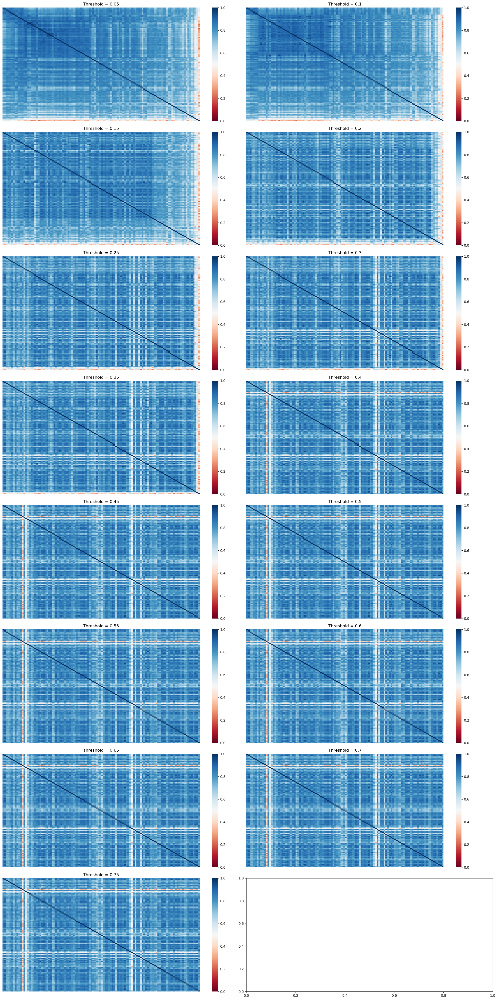

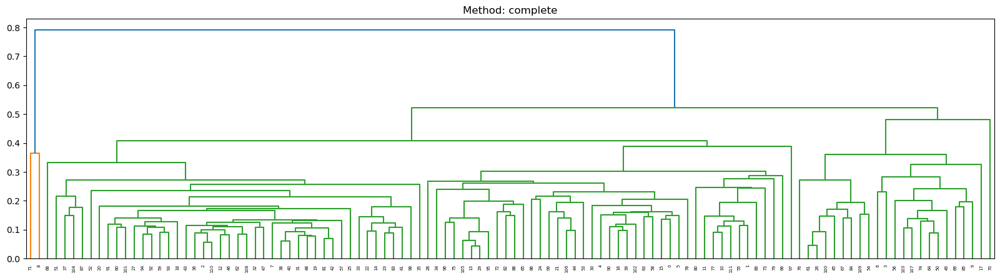

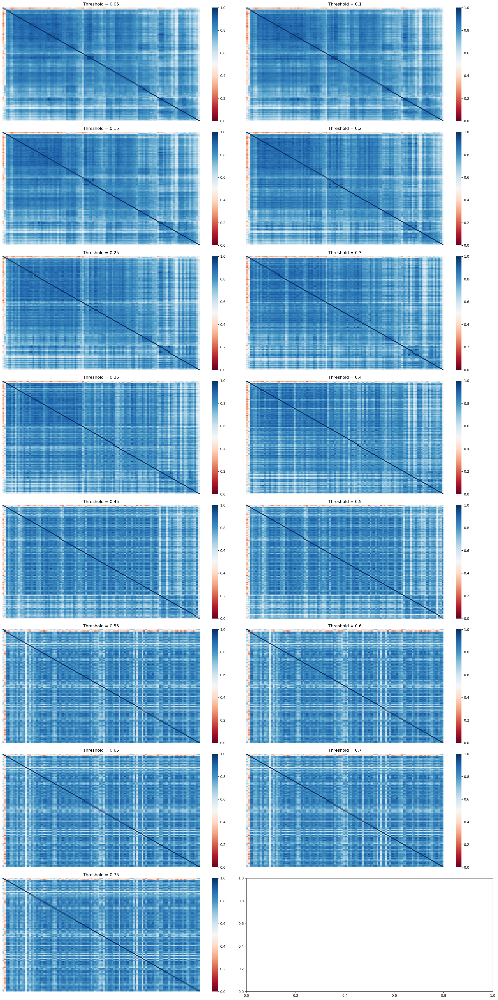

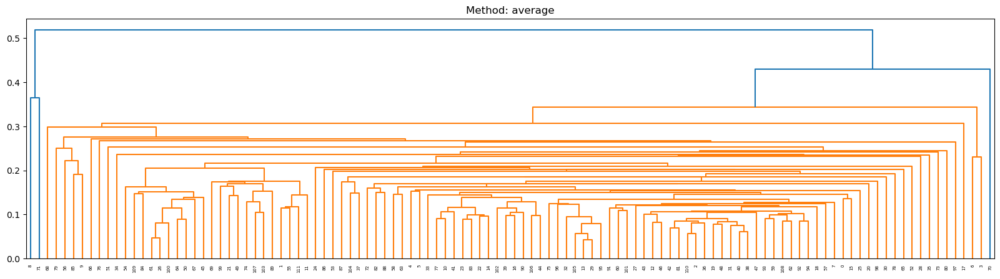

...

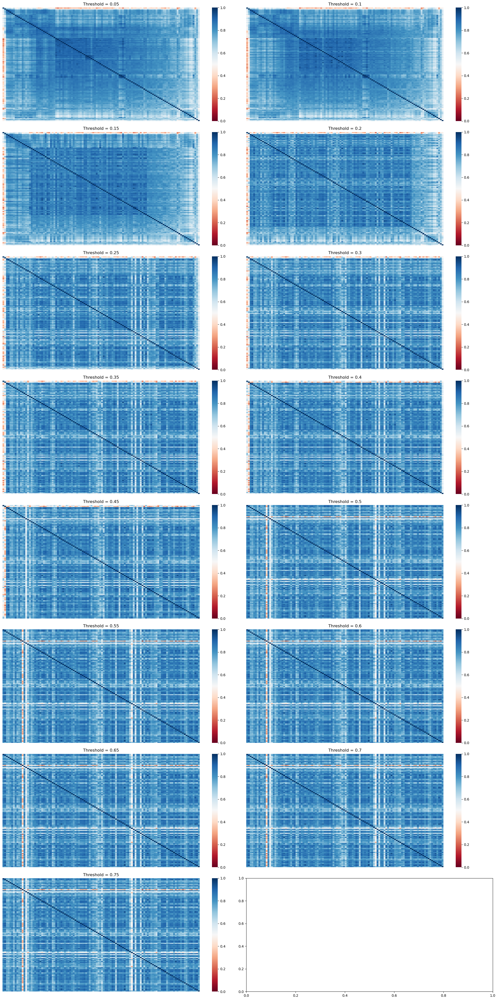

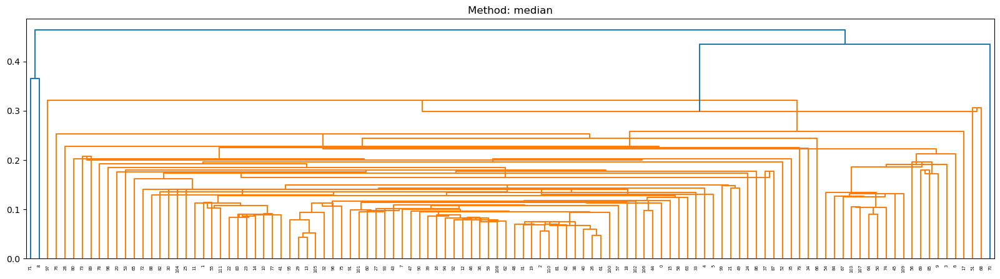

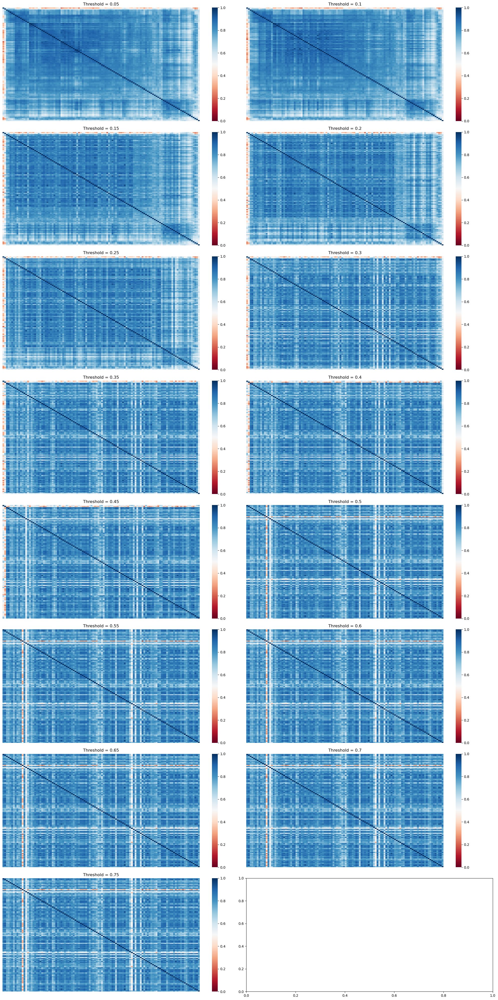

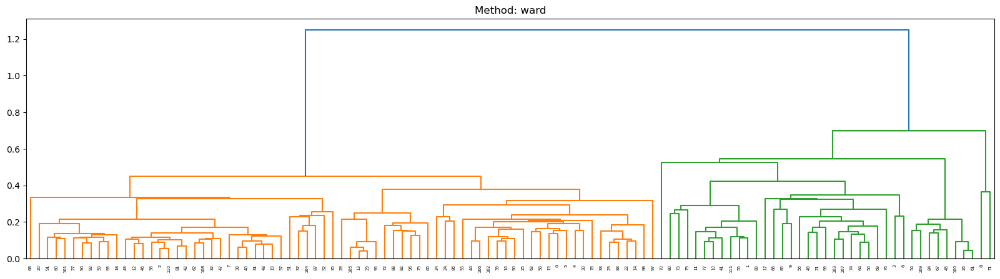

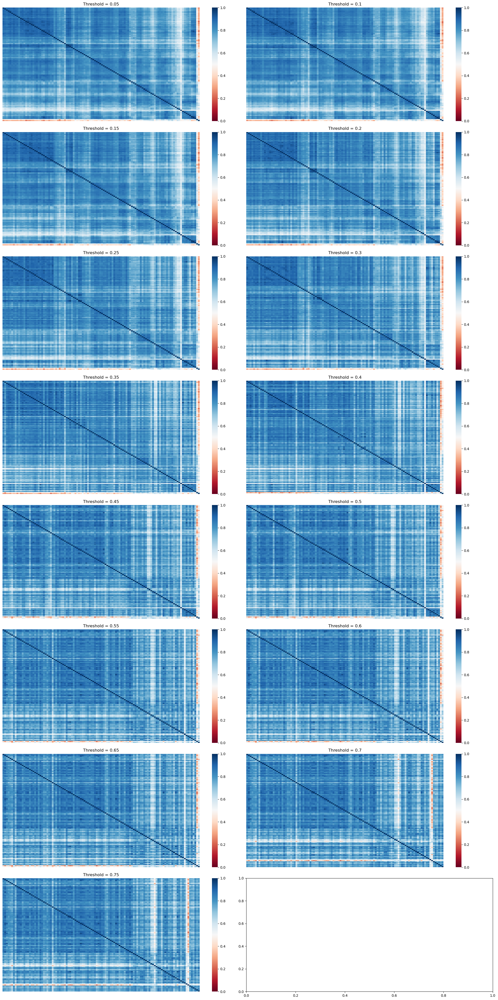

In [253]:
## Cluster the correlation matrices using https://www.kaggle.com/code/sgalella/correlation-heatmaps-with-hierarchical-clustering

dissimilarity = 1 - abs(target_corr_mat)

for method in ['single','complete','average','weighted','centroid','median','ward']:
    Z = linkage(y=squareform(dissimilarity), method=method, optimal_ordering=True)
    plt.figure(figsize=(20,5))
    plt.title("Method: {}".format(method))
    dendrogram(Z)
    plt.show()

    fig, axes = plt.subplots(8, 2, figsize=(20, 40))

    for idx, t in enumerate(np.arange(0.05, 0.8, 0.05)):
        # Calculate the cluster
        labels = fcluster(Z, t, criterion='distance')

        # Keep the indices to sort labels
        labels_order = np.argsort(labels)

        # Build a new dataframe with the sorted columns
        clustered = pd.concat([train_common_time_ids_df[i] for i in train_common_time_ids_df.columns[labels_order]], axis=1)

        # Get the current axes
        ax = axes[idx // 2, idx % 2]

        # Plot the correlation heatmap
        correlations = clustered.corr()
        sns.heatmap(round(correlations, 2), cmap='RdBu', vmin=0, vmax=1,
                    xticklabels=False, yticklabels=False, ax=ax)
        ax.set_title("Threshold = {}".format(round(t, 2)))

    # Adjust layout for better spacing
    plt.tight_layout()

    # Show the plot
    plt.show()

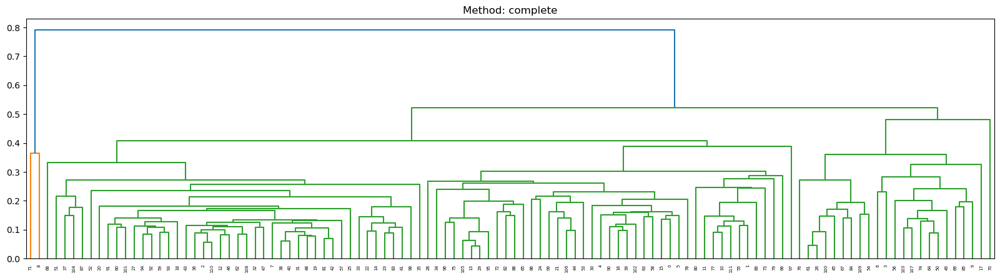

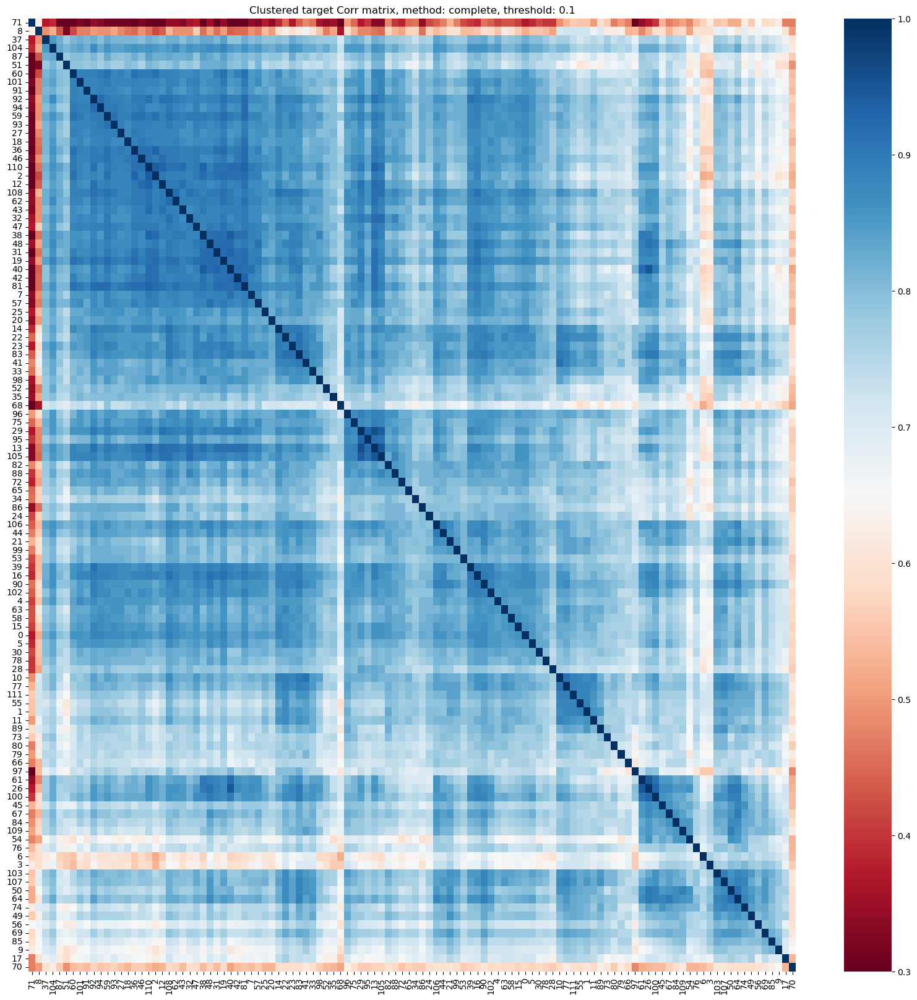

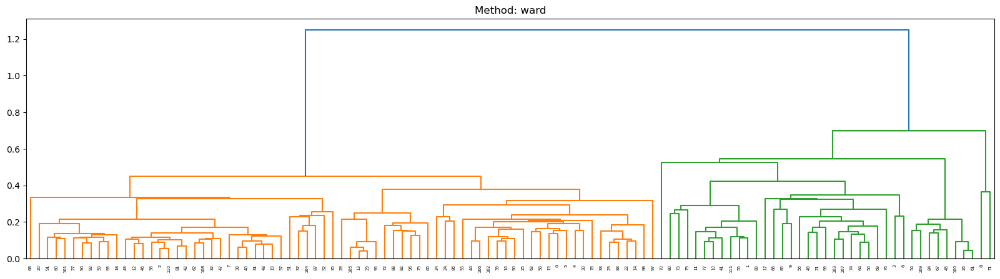

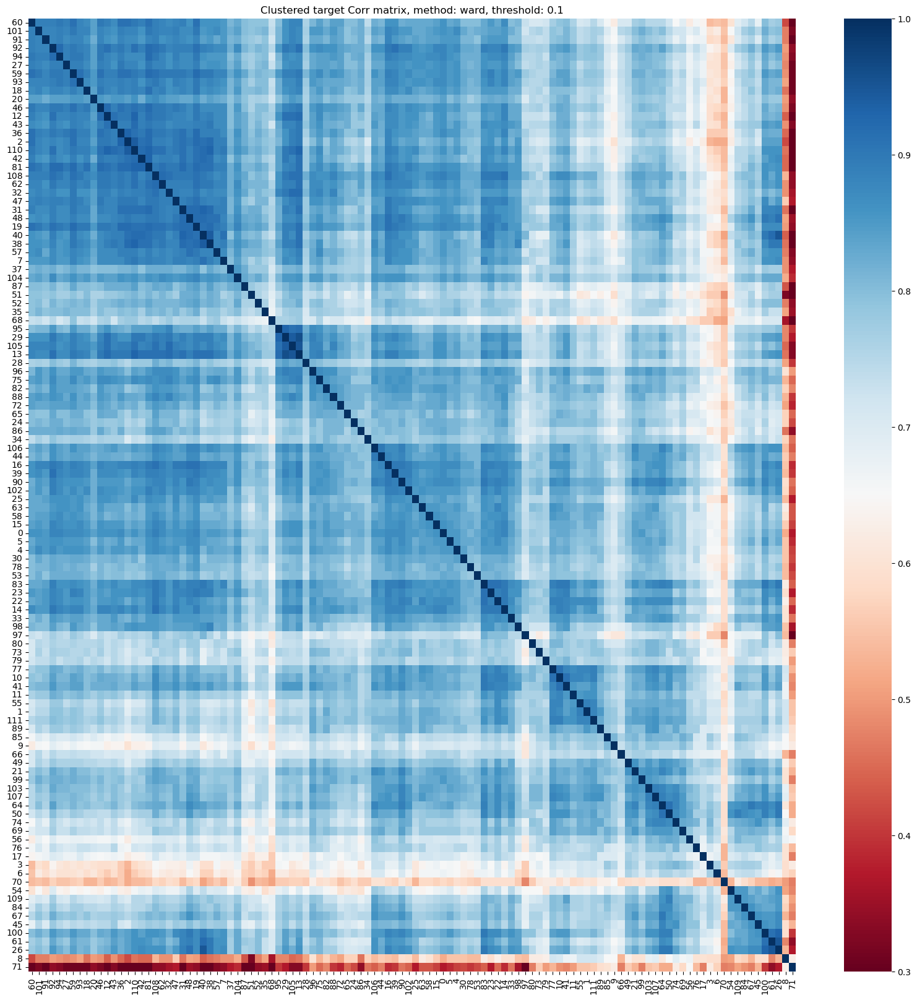

In [288]:
## Only plot the BEST Cluster formation 

dissimilarity = 1 - abs(target_corr_mat)

for method in ['complete','ward']:
    Z = linkage(y=squareform(dissimilarity), method=method, optimal_ordering=True)
    plt.figure(figsize=(20,5))
    plt.title("Method: {}".format(method))
    dendrogram(Z)
    plt.show()


    for idx, t in enumerate(np.arange(0.1, 0.2, 0.1)):
        # Calculate the cluster
        labels = fcluster(Z, t, criterion='distance')

        # Keep the indices to sort labels
        labels_order = np.argsort(labels)

        # Build a new dataframe with the sorted columns
        clustered = pd.concat([train_common_time_ids_df[i] for i in train_common_time_ids_df.columns[labels_order]], axis=1)

        # Plot the correlation heatmap
        correlations = clustered.corr()
        plt.figure(figsize=(20,20))
        sns.heatmap(round(correlations, 2), cmap='RdBu', vmin=0.3, vmax=1,
                    xticklabels=labels_order, yticklabels=labels_order)
        plt.title(f'Clustered target Corr matrix, method: {method}, threshold: {t}')
        plt.show()        
        # plt.figure(figsize=(12,8))
        # sns.heatmap(correlations, cmap='RdBu' , vmin=0.3, vmax=1,)
        # plt.title(f'Clustered target Corr matrix, method: {method}, threshold: {t}')
        # plt.show()  



In [ ]:
# sns.clustermap(target_corr_mat, method="complete", cmap='RdBu', annot=True, 
#                annot_kws={"size": 7}, vmin=-1, vmax=1, figsize=(15,12))